# Import

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns 

import os
from os import listdir
from os.path import isfile, join, isdir

# Read df

pid_dis     : pid and disease 
df          : temp df literally pid_dis but pid as index, used for plt
d           : pid and file_name
DF(main)    :Merge of pid_dis and d 


In [2]:
pid_dis = pd.read_csv(r'lung/download/Respiratory_Sound_Database/Respiratory_Sound_Database/patient_diagnosis.csv',
                    names=["Pid","dis"])

# cleaning directory

Found files are duplicated 

In [3]:
dir_=r"lung/download/Respiratory_Sound_Database/Respiratory_Sound_Database"

In [4]:
listdir(dir_)

['.dist',
 'audio_and_txt_files',
 'filename_differences.txt',
 'filename_format.txt',
 'patient_diagnosis.csv']

In [5]:
"""from os import remove

# custom made function for deleating duplicate entries having _1 at end eg duplicate file "fileName_1" 
def clean(p):
    c=0
    for i in listdir(p):
        pp=join(p,i)
        
        if isdir(pp):
            print(f"dir\t {i}\n")
            clean(pp)
        else:
            if i.split(".")[0].split("_")[-1] =="1":
                c+=1
                remove(pp)
    print(c)        
"""

'from os import remove\n\n# custom made function for deleating duplicate entries having _1 at end eg duplicate file "fileName_1" \ndef clean(p):\n    c=0\n    for i in listdir(p):\n        pp=join(p,i)\n        \n        if isdir(pp):\n            print(f"dir\t {i}\n")\n            clean(pp)\n        else:\n            if i.split(".")[0].split("_")[-1] =="1":\n                c+=1\n                remove(pp)\n    print(c)        \n'

In [6]:
#clean(pth)

# Analysing

### dummy df

In [7]:
# just trying with diff df with id as index
df=pd.read_csv(r"lung/download/Respiratory_Sound_Database/Respiratory_Sound_Database/patient_diagnosis.csv",
               names=["Id","Result"],index_col="Id")
df

,Result
Id,
101,URTI
102,Healthy
103,Asthma
104,COPD
105,URTI
...,...
222,COPD
223,COPD
224,Healthy


In [8]:
yax=df.Result.value_counts(sort=False)
yax.index

Index(['URTI', 'Healthy', 'Asthma', 'COPD', 'LRTI', 'Bronchiectasis',
       'Pneumonia', 'Bronchiolitis'],
      dtype='object')

In [9]:
custom_lables=[f"{nme} ({count})"for nme,count in zip(yax.index,yax.values) ]
custom_lables

['URTI (14)',
 'Healthy (26)',
 'Asthma (1)',
 'COPD (64)',
 'LRTI (2)',
 'Bronchiectasis (7)',
 'Pneumonia (6)',
 'Bronchiolitis (6)']

In [10]:
yax.index

Index(['URTI', 'Healthy', 'Asthma', 'COPD', 'LRTI', 'Bronchiectasis',
       'Pneumonia', 'Bronchiolitis'],
      dtype='object')

### CountPLot

C:\Users\Irshad Yasseen A\AppData\Local\Temp\ipykernel_66636\4032450643.py:1: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(df["Result"],palette="rocket")


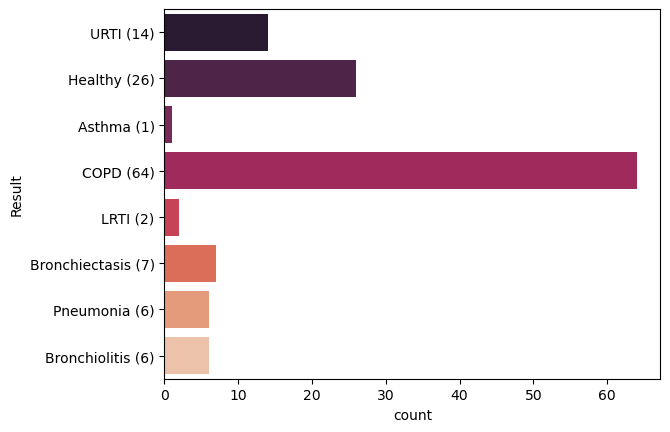

In [11]:
sns.countplot(df["Result"],palette="rocket")
plt.yticks(range(len(custom_lables)),custom_lables) 
plt.show()

# Getting pid and file name from files 

In [12]:
pth="lung/download/Respiratory_Sound_Database/Respiratory_Sound_Database/audio_and_txt_files"

files=[i.split(".")[0] for i in listdir(pth) if "txt" in i ]
l=[i.split("_")[0] for i in files]

d=pd.DataFrame(zip(l,files),columns=["Pid","file_name"]) 

In [13]:
d.head()

,Pid,file_name
0,101,101_1b1_Al_sc_Meditron
1,101,101_1b1_Pr_sc_Meditron
2,102,102_1b1_Ar_sc_Meditron
3,104,104_1b1_Al_sc_Litt3200
4,104,104_1b1_Ar_sc_Litt3200


In [14]:
len(d) #total p

917

## Changing col types

In [15]:
d.dtypes 

Pid          object
file_name    object
dtype: object

In [16]:
d.Pid=d.Pid.astype(int)
d.file_name=d.file_name.astype(str)

In [17]:
d.dtypes

Pid           int32
file_name    object
dtype: object

In [18]:
pid_dis.dtypes

Pid     int64
dis    object
dtype: object

# Merge df1 and d

In [19]:
DF=pd.merge(pid_dis,d,on="Pid")
DF

,Pid,dis,file_name
0,101,URTI,101_1b1_Al_sc_Meditron
1,101,URTI,101_1b1_Pr_sc_Meditron
2,102,Healthy,102_1b1_Ar_sc_Meditron
3,104,COPD,104_1b1_Al_sc_Litt3200
4,104,COPD,104_1b1_Ar_sc_Litt3200
...,...,...,...
912,224,Healthy,224_1b2_Al_sc_Meditron
913,225,Healthy,225_1b1_Pl_sc_Meditron
914,226,Pneumonia,226_1b1_Al_sc_Meditron
915,226,Pneumonia,226_1b1_Ll_sc_Meditron


# Reducing baises

### Fishy segment??

In [20]:
df

,Result
Id,
101,URTI
102,Healthy
103,Asthma
104,COPD
105,URTI
...,...
222,COPD
223,COPD
224,Healthy


In [21]:
d

,Pid,file_name
0,101,101_1b1_Al_sc_Meditron
1,101,101_1b1_Pr_sc_Meditron
2,102,102_1b1_Ar_sc_Meditron
3,104,104_1b1_Al_sc_Litt3200
4,104,104_1b1_Ar_sc_Litt3200
...,...,...
912,224,224_1b2_Al_sc_Meditron
913,225,225_1b1_Pl_sc_Meditron
914,226,226_1b1_Al_sc_Meditron
915,226,226_1b1_Ll_sc_Meditron


In [22]:
df.index.unique().__len__() 

126

In [23]:
(d["Pid"]).unique().__len__() # paathingala frannz 3 kamia iruku... OI EPURAAAA...

123

#### DF


In [24]:
DF.__len__()

917

####### Apo vanthuchu ipo varathu o/p uhh mulikatha 

In [25]:
#droping asthma and lrti 
#tis updated code as there wot be any Asthma or lrti in DF bcs DF=merge(DF,d) 
#dir la asthma and lrti remove panita la so merge panrapo automatically include aavathu DF la
DF.query("dis == 'Asthma' or dis =='LRTI' "  )

,Pid,dis,file_name


##### verifying the vanish of Asthma and lrti 

In [26]:
# oru vela inum olinjitirukano???
#enna oru santhega buthi 

In [27]:
d.iloc[3],df.iloc[3]

(Pid                             104
 file_name    104_1b1_Al_sc_Litt3200
 Name: 3, dtype: object,
 Result    COPD
 Name: 104, dtype: object)

In [28]:
DF.iloc[3]

Pid                             104
dis                            COPD
file_name    104_1b1_Al_sc_Litt3200
Name: 3, dtype: object

In [29]:
d['Pid'].__len__()

917

In [30]:
df

,Result
Id,
101,URTI
102,Healthy
103,Asthma
104,COPD
105,URTI
...,...
222,COPD
223,COPD
224,Healthy


In [31]:
print("DF  d   d   df")
print(DF.__len__(),d.__len__(),d["Pid"].unique().__len__(),df.__len__())
#DF d d df

DF  d   d   df
917 917 123 126


In [32]:
# not needed anymore
# DF=DF.drop([3,108,115])

In [33]:
(DF.dis=="LRTI").sum(), (DF.dis=="Asthma").sum()

(0, 0)

In [34]:
# Finally convienced that lrti and asthma are eradicated 
# Racist me XD XD XD

In [35]:
#code for removing files of LRTI and asthma thirupu run panna time waste since files already del from dir_
"""for i in listdir(dir_):
    
    if i.split('_')[0] in ["103","108","115"] :
        print(join(dir_,i))
        os.remove(join(dir_,i))
"""

'for i in listdir(dir_):\n    \n    if i.split(\'_\')[0] in ["103","108","115"] :\n        print(join(dir_,i))\n        os.remove(join(dir_,i))\n'

In [36]:
DF.dis.unique()

array(['URTI', 'Healthy', 'COPD', 'Bronchiectasis', 'Pneumonia',
       'Bronchiolitis'], dtype=object)

###  Audio files count plot

In [37]:
DF.dis.value_counts()

COPD              793
Pneumonia          37
Healthy            35
URTI               23
Bronchiectasis     16
Bronchiolitis      13
Name: dis, dtype: int64

C:\Users\Irshad Yasseen A\AppData\Local\Temp\ipykernel_66636\3432374845.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=DF,y="dis",palette="rocket",stat="percent")


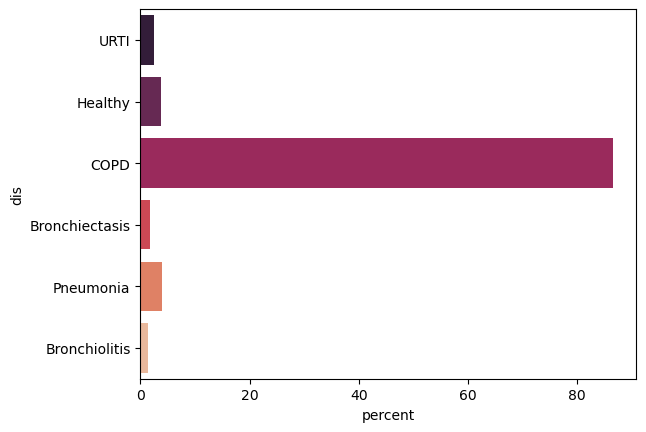

In [38]:
#ayo ivlo biase aa 
sns.countplot(data=DF,y="dis",palette="rocket",stat="percent")
plt.show()

In [39]:
DF.groupby("Pid").count().sort_values("dis",ascending=0)[:20]

,dis,file_name
Pid,,
130,66,66
107,28,28
151,28,28
172,27,27
138,27,27
170,25,25
178,24,24
162,24,24
158,24,24


#### should analyse more on tha audios later proceeding now

In [40]:
dir_="lung/download/Respiratory_Sound_Database/Respiratory_Sound_Database/audio_and_txt_files"


In [41]:
len(dir_)

87

## Checking consistency of Pid and filename match 

In [42]:
fun=lambda x: int(x.split("_")[0])
DF["Check"]=DF.Pid==DF["file_name"].apply(fun)

In [43]:
DF

,Pid,dis,file_name,Check
0,101,URTI,101_1b1_Al_sc_Meditron,True
1,101,URTI,101_1b1_Pr_sc_Meditron,True
2,102,Healthy,102_1b1_Ar_sc_Meditron,True
3,104,COPD,104_1b1_Al_sc_Litt3200,True
4,104,COPD,104_1b1_Ar_sc_Litt3200,True
...,...,...,...,...
912,224,Healthy,224_1b2_Al_sc_Meditron,True
913,225,Healthy,225_1b1_Pl_sc_Meditron,True
914,226,Pneumonia,226_1b1_Al_sc_Meditron,True
915,226,Pneumonia,226_1b1_Ll_sc_Meditron,True


In [44]:
DF.Check.value_counts()

True    917
Name: Check, dtype: int64

In [45]:
DF=DF.drop("Check",axis=1)

In [46]:
DF

,Pid,dis,file_name
0,101,URTI,101_1b1_Al_sc_Meditron
1,101,URTI,101_1b1_Pr_sc_Meditron
2,102,Healthy,102_1b1_Ar_sc_Meditron
3,104,COPD,104_1b1_Al_sc_Litt3200
4,104,COPD,104_1b1_Ar_sc_Litt3200
...,...,...,...
912,224,Healthy,224_1b2_Al_sc_Meditron
913,225,Healthy,225_1b1_Pl_sc_Meditron
914,226,Pneumonia,226_1b1_Al_sc_Meditron
915,226,Pneumonia,226_1b1_Ll_sc_Meditron


# Audio Display

In [47]:
#pip install librosa

In [48]:
import IPython.display as ipd
import librosa
import librosa.display

In [49]:
#random pick
DF[DF["Pid"]==188]

,Pid,dis,file_name
676,188,URTI,188_1b1_Al_sc_Meditron
677,188,URTI,188_1b1_Ar_sc_Meditron
678,188,URTI,188_1b1_Pl_sc_Meditron
679,188,URTI,188_1b1_Tc_sc_Meditron


In [50]:
#102 record

def display(file_path,j):
    
    a,s=librosa.load(file_path)
    ipd.Audio(file_path,rate=s)
    plt.figure(figsize=(250,50))
    librosa.display.waveshow(a, sr=s)
    plt.xticks(range(0,21,5))
    plt.title(j,fontsize=225)
# Set the font size for x and y axis ticks
    plt.xticks(fontsize=150)
    plt.yticks(fontsize=175)
    plt.grid()
    ipd.display(ipd.Audio(file_path,rate=s))
display(join(pth,"102_1b1_Ar_sc_Meditron.wav"),"102_1b1_Ar_sc_Meditron.wav") 

In [51]:
healthy_df=DF[(DF['dis'] == 'Healthy') & (DF.groupby('Pid')['Pid'].transform('count') == 1)]
list(healthy_df.file_name)

['102_1b1_Ar_sc_Meditron',
 '123_1b1_Al_sc_Meditron',
 '125_1b1_Tc_sc_Meditron',
 '126_1b1_Al_sc_Meditron',
 '127_1b1_Ar_sc_Meditron',
 '136_1b1_Ar_sc_Meditron',
 '143_1b1_Al_sc_Meditron',
 '152_1b1_Al_sc_Meditron',
 '153_1b1_Al_sc_Meditron',
 '171_1b1_Al_sc_Meditron',
 '182_1b1_Tc_sc_Meditron',
 '184_1b1_Ar_sc_Meditron',
 '187_1b1_Ll_sc_Meditron',
 '202_1b1_Ar_sc_Meditron',
 '208_1b1_Ll_sc_Meditron',
 '209_1b1_Tc_sc_Meditron',
 '214_1b1_Ar_sc_Meditron',
 '217_1b1_Tc_sc_Meditron',
 '225_1b1_Pl_sc_Meditron']

## Thorakathaaaaaa!!!!!

In [52]:
for i in list(healthy_df.file_name)[:3]:
    j=f"{i}.wav"
    print(j)
    display(join(pth,j),j)

102_1b1_Ar_sc_Meditron.wav


123_1b1_Al_sc_Meditron.wav


125_1b1_Tc_sc_Meditron.wav


# Processing

#### Mods

####### functions (exp ltr)

In [53]:
#display file
def dis(file,s):
    plt.figure(figsize=(250,50))
    librosa.display.waveshow(file, sr=s)
    plt.xticks(range(0,21,5))
    plt.title(s,fontsize=225)
# Set the font size for x and y axis ticks
    plt.xticks(fontsize=150)
    plt.yticks(fontsize=175)
    plt.grid()
    ipd.display(ipd.Audio(file,rate=s))

In [54]:
def add_noise(data,x):
    """types :
    """
    env_noise = np.random.randn(len(data)) #gaussian noise enviroinmental
    white_noise=np.random.normal(len(data))

    data_noise = data + x * env_noise
    return data_noise

def shift(data,x):
    return np.roll(data, x)  #reorder cut from end and attach at start

def stretch(data, rate):

    data = librosa.effects.time_stretch(data, rate=rate)    # mod speed pitch=const 
    return data

def pitch_shift (data ,sr, rate):                                           #pitch scale oppo of stretch change pitch keep speed const
    
    n_steps = int(rate * len(data) / sr)        #idk wat it does gives error
    data = librosa.effects.pitch_shift(data,sr=sr, rate=rate, n_steps= n_steps)
    return data

def impulse():
    #reverb for music mostly
    pass

def filt():
    """lospass pass"""

def polarityinverse():
 # sound * -1
    pass
#def randomgain()

In [55]:
test_sound=np.zeros(10000)
nse=np.random.normal(0,test_sound.std())

## Testing mods

In [56]:
a,s=librosa.load("lung/download/Respiratory_Sound_Database/Respiratory_Sound_Database/audio_and_txt_files/106_2b1_Pr_mc_LittC2SE.wav")
a

array([ 0.13928288,  0.20430763,  0.18189679, ..., -0.07231919,
       -0.07211972, -0.08202649], dtype=float32)

In [57]:
dis(a,s)
dis(add_noise(a,0.001),s)

# MFCC

In [58]:
y = librosa.feature.mfcc(y=a, sr=s, n_mfcc=50)
y

array([[-213.82349   , -279.306     , -432.35718   , ..., -442.52036   ,
        -391.72247   , -284.1073    ],
       [ 120.21038   ,  122.60533   ,  109.17192   , ...,  101.645294  ,
         130.01778   ,  119.178734  ],
       [  14.674295  ,   17.920662  ,   76.8659    , ...,   85.66568   ,
          60.131508  ,   37.589645  ],
       ...,
       [   2.8026426 ,    3.2721562 ,    5.2089753 , ...,    1.8907199 ,
          -1.2462382 ,   -1.9843999 ],
       [   1.4681633 ,    2.7813802 ,    4.6372967 , ...,    1.6375022 ,
          -1.085124  ,   -2.380376  ],
       [   2.825974  ,    3.3494625 ,    3.1440127 , ...,    0.44695297,
          -0.979398  ,   -2.0053477 ]], dtype=float32)

In [59]:
y.shape

(50, 862)

In [60]:
ynoise=librosa.feature.mfcc(y=add_noise(a,0.001), sr=s, n_mfcc=50)
ynoise

array([[-2.12857033e+02, -2.73711590e+02, -4.01579996e+02, ...,
        -4.01395752e+02, -3.63585087e+02, -2.81436607e+02],
       [ 1.19055645e+02,  1.15882431e+02,  9.19529755e+01, ...,
         8.70560046e+01,  1.06186745e+02,  1.16183157e+02],
       [ 1.51577212e+01,  2.21415630e+01,  7.08747881e+01, ...,
         7.55594067e+01,  6.28977804e+01,  3.85903080e+01],
       ...,
       [ 2.78494945e+00,  3.12576662e+00,  4.85023874e+00, ...,
         1.27075179e+00, -1.34297179e+00, -1.21423664e+00],
       [ 1.00926630e+00,  2.29208206e+00,  2.51175059e+00, ...,
         4.67529082e-01, -1.79740505e+00, -3.07362227e+00],
       [ 3.33487835e+00,  3.88176990e+00,  5.52693698e+00, ...,
         1.18854888e+00, -3.00956172e-01, -2.00379439e+00]])

In [61]:
ym=np.mean(ynoise.T,axis=0)

In [62]:
ym.shape

(50,)

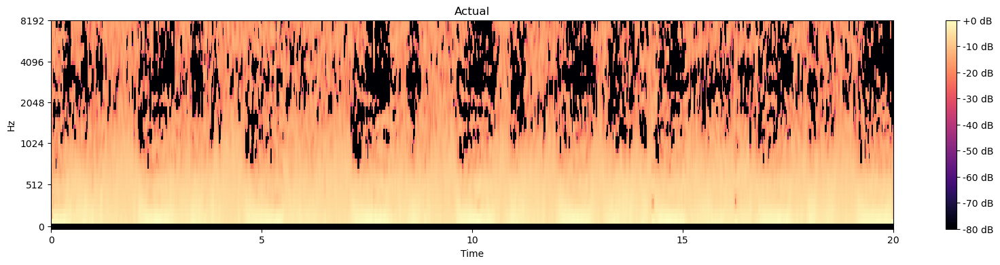

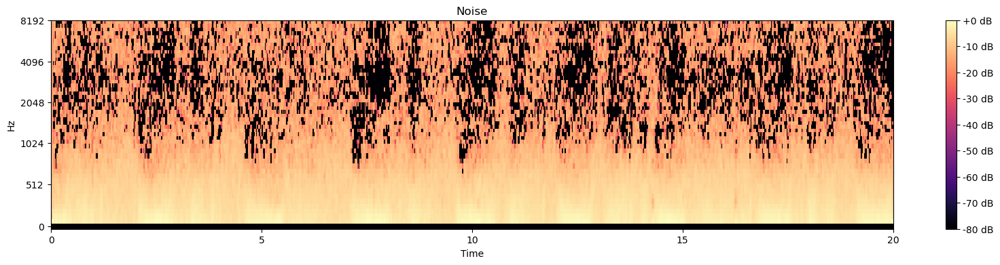

In [63]:
plt.figure(figsize=(20,4),dpi=100)
plt.title("Actual")
librosa.display.specshow(librosa.power_to_db(y,ref=np.max),
                             y_axis='mel',
                             fmax=8000,
                             x_axis='time')
plt.colorbar(format='%+2.0f dB')

plt.figure(figsize=(20,4),dpi=100)
plt.title("Noise")
librosa.display.specshow(librosa.power_to_db(ynoise,ref=np.max),
                             y_axis='mel',
                             fmax=8000,
                             x_axis='time')
plt.colorbar(format='%+2.0f dB')



# Functioin for feacture extracion 

In [64]:
def fe(file):
    a,s=librosa.load(file);
    m= librosa.feature.mfcc(y=add_noise(a,0.001), sr=s, n_mfcc=500)
    mfc_mean=np.mean(m.T,axis=0)
    return(mfc_mean)


In [65]:
dir_="lung/download/Respiratory_Sound_Database/Respiratory_Sound_Database/audio_and_txt_files"
dir_

'lung/download/Respiratory_Sound_Database/Respiratory_Sound_Database/audio_and_txt_files'

In [66]:
fe(dir_+"/172_1b3_Tc_mc_AKGC417L.wav")

array([-2.55039477e+02,  1.48009690e+02,  4.15069267e+01,  3.18302255e+01,
        3.37343810e+01,  2.30403569e+01,  2.57993483e+00,  1.76845992e+00,
        1.51253677e+01,  2.17098951e+01,  2.10913086e+01,  1.69613632e+01,
        1.07876731e+01, -1.77332222e+00, -3.54755603e+00, -3.87957235e+00,
        5.28436968e-02,  5.79241224e+00, -4.54022010e+00,  1.39891993e+00,
        6.48862655e+00,  2.93651014e+00,  5.80174327e+00,  7.11199113e-02,
        1.43168817e+00,  8.01514629e+00,  6.32922574e+00,  8.30418383e-01,
       -2.81251626e-01,  4.74926743e+00, -1.55247038e+00, -1.55567515e-01,
        3.34400189e+00,  2.05040413e+00, -6.99074847e-01, -1.46921039e+00,
        3.72569309e-01,  1.65672277e-01, -6.52850191e-01,  1.04703720e+00,
       -4.10448694e+00,  8.38505530e-01,  5.48321954e-01, -5.69529466e-01,
        3.03363009e+00,  1.35571827e+00,  2.82425559e+00,  1.32263192e+00,
        8.36244869e-01,  1.70781440e+00, -1.93585681e-01,  1.47438816e+00,
       -5.26625594e-02, -

# Checking consistency of filename col and the audio files in dir_ 

In [67]:
from tqdm import tqdm

In [68]:
# Caught a bug in audio files and df later in the code paya kadupethitan eppa (tat asthma and lrti boys)
DF.reset_index(inplace=True)
DF.drop("index",axis=1,inplace=True)

In [69]:
DF

,Pid,dis,file_name
0,101,URTI,101_1b1_Al_sc_Meditron
1,101,URTI,101_1b1_Pr_sc_Meditron
2,102,Healthy,102_1b1_Ar_sc_Meditron
3,104,COPD,104_1b1_Al_sc_Litt3200
4,104,COPD,104_1b1_Ar_sc_Litt3200
...,...,...,...
912,224,Healthy,224_1b2_Al_sc_Meditron
913,225,Healthy,225_1b1_Pl_sc_Meditron
914,226,Pneumonia,226_1b1_Al_sc_Meditron
915,226,Pneumonia,226_1b1_Ll_sc_Meditron


In [70]:
c=0
l=[]
for soundDir in tqdm(os.listdir(dir_)):
    if soundDir.endswith('.wav'):
                print(os.path.abspath(soundDir),c)
                l.append(soundDir[:-4])
                c+=1


100%|██████████| 1834/1834 [00:00<00:00, 460426.98it/s]

d:\Vs\101_1b1_Al_sc_Meditron.wav 0
d:\Vs\101_1b1_Pr_sc_Meditron.wav 1
d:\Vs\102_1b1_Ar_sc_Meditron.wav 2
d:\Vs\104_1b1_Al_sc_Litt3200.wav 3
d:\Vs\104_1b1_Ar_sc_Litt3200.wav 4
d:\Vs\104_1b1_Ll_sc_Litt3200.wav 5
d:\Vs\104_1b1_Lr_sc_Litt3200.wav 6
d:\Vs\104_1b1_Pl_sc_Litt3200.wav 7
d:\Vs\104_1b1_Pr_sc_Litt3200.wav 8
d:\Vs\105_1b1_Tc_sc_Meditron.wav 9
d:\Vs\106_2b1_Pl_mc_LittC2SE.wav 10
d:\Vs\106_2b1_Pr_mc_LittC2SE.wav 11
d:\Vs\107_2b3_Al_mc_AKGC417L.wav 12
d:\Vs\107_2b3_Ar_mc_AKGC417L.wav 13
d:\Vs\107_2b3_Ll_mc_AKGC417L.wav 14
d:\Vs\107_2b3_Lr_mc_AKGC417L.wav 15
d:\Vs\107_2b3_Pl_mc_AKGC417L.wav 16
d:\Vs\107_2b3_Pr_mc_AKGC417L.wav 17
d:\Vs\107_2b3_Tc_mc_AKGC417L.wav 18
d:\Vs\107_2b4_Al_mc_AKGC417L.wav 19
d:\Vs\107_2b4_Ar_mc_AKGC417L.wav 20
d:\Vs\107_2b4_Ll_mc_AKGC417L.wav 21
d:\Vs\107_2b4_Lr_mc_AKGC417L.wav 22
d:\Vs\107_2b4_Pl_mc_AKGC417L.wav 23
d:\Vs\107_2b4_Pr_mc_AKGC417L.wav 24
d:\Vs\107_2b4_Tc_mc_AKGC417L.wav 25
d:\Vs\107_2b5_Al_mc_AKGC417L.wav 26
d:\Vs\107_2b5_Ar_mc_AKGC417L.wav 27
d:

In [71]:
 DF["aud_pth"]=l

In [72]:
DF

,Pid,dis,file_name,aud_pth
0,101,URTI,101_1b1_Al_sc_Meditron,101_1b1_Al_sc_Meditron
1,101,URTI,101_1b1_Pr_sc_Meditron,101_1b1_Pr_sc_Meditron
2,102,Healthy,102_1b1_Ar_sc_Meditron,102_1b1_Ar_sc_Meditron
3,104,COPD,104_1b1_Al_sc_Litt3200,104_1b1_Al_sc_Litt3200
4,104,COPD,104_1b1_Ar_sc_Litt3200,104_1b1_Ar_sc_Litt3200
...,...,...,...,...
912,224,Healthy,224_1b2_Al_sc_Meditron,224_1b2_Al_sc_Meditron
913,225,Healthy,225_1b1_Pl_sc_Meditron,225_1b1_Pl_sc_Meditron
914,226,Pneumonia,226_1b1_Al_sc_Meditron,226_1b1_Al_sc_Meditron
915,226,Pneumonia,226_1b1_Ll_sc_Meditron,226_1b1_Ll_sc_Meditron


In [73]:
dir_

'lung/download/Respiratory_Sound_Database/Respiratory_Sound_Database/audio_and_txt_files'

In [74]:
pd.DataFrame(DF.file_name==DF.aud_pth).value_counts()

True    917
dtype: int64

In [75]:
DF

,Pid,dis,file_name,aud_pth
0,101,URTI,101_1b1_Al_sc_Meditron,101_1b1_Al_sc_Meditron
1,101,URTI,101_1b1_Pr_sc_Meditron,101_1b1_Pr_sc_Meditron
2,102,Healthy,102_1b1_Ar_sc_Meditron,102_1b1_Ar_sc_Meditron
3,104,COPD,104_1b1_Al_sc_Litt3200,104_1b1_Al_sc_Litt3200
4,104,COPD,104_1b1_Ar_sc_Litt3200,104_1b1_Ar_sc_Litt3200
...,...,...,...,...
912,224,Healthy,224_1b2_Al_sc_Meditron,224_1b2_Al_sc_Meditron
913,225,Healthy,225_1b1_Pl_sc_Meditron,225_1b1_Pl_sc_Meditron
914,226,Pneumonia,226_1b1_Al_sc_Meditron,226_1b1_Al_sc_Meditron
915,226,Pneumonia,226_1b1_Ll_sc_Meditron,226_1b1_Ll_sc_Meditron


In [76]:
DF.drop("aud_pth",axis=1)

,Pid,dis,file_name
0,101,URTI,101_1b1_Al_sc_Meditron
1,101,URTI,101_1b1_Pr_sc_Meditron
2,102,Healthy,102_1b1_Ar_sc_Meditron
3,104,COPD,104_1b1_Al_sc_Litt3200
4,104,COPD,104_1b1_Ar_sc_Litt3200
...,...,...,...
912,224,Healthy,224_1b2_Al_sc_Meditron
913,225,Healthy,225_1b1_Pl_sc_Meditron
914,226,Pneumonia,226_1b1_Al_sc_Meditron
915,226,Pneumonia,226_1b1_Ll_sc_Meditron


In [77]:
DF

,Pid,dis,file_name,aud_pth
0,101,URTI,101_1b1_Al_sc_Meditron,101_1b1_Al_sc_Meditron
1,101,URTI,101_1b1_Pr_sc_Meditron,101_1b1_Pr_sc_Meditron
2,102,Healthy,102_1b1_Ar_sc_Meditron,102_1b1_Ar_sc_Meditron
3,104,COPD,104_1b1_Al_sc_Litt3200,104_1b1_Al_sc_Litt3200
4,104,COPD,104_1b1_Ar_sc_Litt3200,104_1b1_Ar_sc_Litt3200
...,...,...,...,...
912,224,Healthy,224_1b2_Al_sc_Meditron,224_1b2_Al_sc_Meditron
913,225,Healthy,225_1b1_Pl_sc_Meditron,225_1b1_Pl_sc_Meditron
914,226,Pneumonia,226_1b1_Al_sc_Meditron,226_1b1_Al_sc_Meditron
915,226,Pneumonia,226_1b1_Ll_sc_Meditron,226_1b1_Ll_sc_Meditron


In [78]:
len(listdir(dir_))/2

917.0

# X

Calc MFCC for all audio files 

In [79]:
pth

'lung/download/Respiratory_Sound_Database/Respiratory_Sound_Database/audio_and_txt_files'

In [80]:
"""x=[]
# took 7mins to run
for i in tqdm(listdir(dir_)):
    if i.split(".")[1]=="wav":
        x.append(fe(f"{dir_}/{i}"))
        print(x)"""

'x=[]\n# took 7mins to run\nfor i in tqdm(listdir(dir_)):\n    if i.split(".")[1]=="wav":\n        x.append(fe(f"{dir_}/{i}"))\n        print(x)'

In [81]:
#not ptinting x and only 43s to run  if i do it with np then array is of double the size
x=[]
for i in tqdm(listdir(dir_)):
    if i.split(".")[1]=="wav":
        x.append(fe(f"{dir_}/{i}"))
        

100%|██████████| 1834/1834 [00:46<00:00, 39.08it/s]


In [82]:
x=np.array(x)
x

array([[-4.29330309e+02,  5.62520641e+01,  4.90105682e+01, ...,
         2.14412579e-03, -1.71651729e-01, -1.69030992e-01],
       [-4.44946628e+02,  3.66693836e+01,  3.46572834e+01, ...,
        -5.03817011e-02, -5.24492958e-02, -7.81941433e-02],
       [-4.42463133e+02,  4.01470058e+01,  3.70712816e+01, ...,
        -2.30442192e-02, -5.37161643e-02, -1.22710176e-02],
       ...,
       [-4.25541788e+02,  5.94283622e+01,  4.71415008e+01, ...,
        -1.29287786e-01, -4.03478674e-03,  5.78533808e-02],
       [-4.23410270e+02,  6.33920239e+01,  5.34566926e+01, ...,
        -8.63790776e-02, -1.79732311e-02,  2.72175721e-02],
       [-4.31739954e+02,  5.28034178e+01,  4.59453915e+01, ...,
        -4.77784506e-02,  6.91858954e-02, -1.57596920e-02]])

In [83]:
np.shape(x)

(917, 128)

# Y

In [84]:
y.shape

(50, 862)

In [85]:
y=DF.dis
y

0           URTI
1           URTI
2        Healthy
3           COPD
4           COPD
         ...    
912      Healthy
913      Healthy
914    Pneumonia
915    Pneumonia
916    Pneumonia
Name: dis, Length: 917, dtype: object

In [86]:
from sklearn.preprocessing import LabelEncoder

In [87]:
le=LabelEncoder()
y=le.fit_transform(y)

In [88]:
y[:10],y.shape

(array([5, 5, 3, 2, 2, 2, 2, 2, 2, 5]), (917,))

In [89]:
y

array([5, 5, 3, 2, 2, 2, 2, 2, 2, 5, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 5, 2, 2, 2, 2, 2, 3, 3, 4,
       4, 4, 4, 4, 4, 4, 4, 4, 3, 2, 2, 2, 2, 2, 2, 3, 3, 3, 2, 5, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 5, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 3, 5, 5, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 4, 4, 4, 4, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3,
       3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 5,

In [90]:
le.inverse_transform(y)

array(['URTI', 'URTI', 'Healthy', 'COPD', 'COPD', 'COPD', 'COPD', 'COPD',
       'COPD', 'URTI', 'COPD', 'COPD', 'COPD', 'COPD', 'COPD', 'COPD',
       'COPD', 'COPD', 'COPD', 'COPD', 'COPD', 'COPD', 'COPD', 'COPD',
       'COPD', 'COPD', 'COPD', 'COPD', 'COPD', 'COPD', 'COPD', 'COPD',
       'COPD', 'COPD', 'COPD', 'COPD', 'COPD', 'COPD', 'COPD', 'COPD',
       'COPD', 'COPD', 'COPD', 'COPD', 'COPD', 'COPD', 'COPD', 'COPD',
       'COPD', 'COPD', 'COPD', 'Bronchiectasis', 'Bronchiectasis', 'COPD',
       'COPD', 'COPD', 'COPD', 'COPD', 'COPD', 'COPD', 'COPD', 'COPD',
       'COPD', 'COPD', 'COPD', 'COPD', 'COPD', 'COPD', 'COPD',
       'Bronchiectasis', 'Bronchiectasis', 'COPD', 'COPD', 'COPD', 'COPD',
       'COPD', 'COPD', 'COPD', 'COPD', 'URTI', 'COPD', 'COPD', 'COPD',
       'COPD', 'COPD', 'Healthy', 'Healthy', 'Pneumonia', 'Pneumonia',
       'Pneumonia', 'Pneumonia', 'Pneumonia', 'Pneumonia', 'Pneumonia',
       'Pneumonia', 'Pneumonia', 'Healthy', 'COPD', 'COPD', 'COPD',
     

# Finally model time


### that annoying moment with thalavali

In [91]:
DF

,Pid,dis,file_name,aud_pth
0,101,URTI,101_1b1_Al_sc_Meditron,101_1b1_Al_sc_Meditron
1,101,URTI,101_1b1_Pr_sc_Meditron,101_1b1_Pr_sc_Meditron
2,102,Healthy,102_1b1_Ar_sc_Meditron,102_1b1_Ar_sc_Meditron
3,104,COPD,104_1b1_Al_sc_Litt3200,104_1b1_Al_sc_Litt3200
4,104,COPD,104_1b1_Ar_sc_Litt3200,104_1b1_Ar_sc_Litt3200
...,...,...,...,...
912,224,Healthy,224_1b2_Al_sc_Meditron,224_1b2_Al_sc_Meditron
913,225,Healthy,225_1b1_Pl_sc_Meditron,225_1b1_Pl_sc_Meditron
914,226,Pneumonia,226_1b1_Al_sc_Meditron,226_1b1_Al_sc_Meditron
915,226,Pneumonia,226_1b1_Ll_sc_Meditron,226_1b1_Ll_sc_Meditron


In [92]:
import pandas as pd

file_path = "tts.txt"
data = {"Pid": [], "Ri": [], "loc": [], "dev": [], "train": []}

with open(file_path, 'r') as file:
    for line in file:
        l = line.strip().split("_")
        l1 = [l[0], l[1], l[2], l[3], l[4].split("\\\\")[0], l[4].split("\\\\")[0]]
        data["Pid"].append(l1[0])
        data["Ri"].append(l1[1])
        data["loc"].append(l1[2])
        data["dev"].append(l1[4].split("\t")[0])
        data["train"].append(l1[4].split("\t")[1])


In [93]:

d = pd.DataFrame(data)


In [94]:
d["Pid"]=d["Pid"].astype("int64")

In [95]:
DF.dtypes

Pid           int64
dis          object
file_name    object
aud_pth      object
dtype: object

In [96]:
d.dtypes

Pid       int64
Ri       object
loc      object
dev      object
train    object
dtype: object

In [97]:
d=d.drop([3,108,115])

In [98]:
d=d.reset_index().drop("index",axis=1)

In [99]:
DF

,Pid,dis,file_name,aud_pth
0,101,URTI,101_1b1_Al_sc_Meditron,101_1b1_Al_sc_Meditron
1,101,URTI,101_1b1_Pr_sc_Meditron,101_1b1_Pr_sc_Meditron
2,102,Healthy,102_1b1_Ar_sc_Meditron,102_1b1_Ar_sc_Meditron
3,104,COPD,104_1b1_Al_sc_Litt3200,104_1b1_Al_sc_Litt3200
4,104,COPD,104_1b1_Ar_sc_Litt3200,104_1b1_Ar_sc_Litt3200
...,...,...,...,...
912,224,Healthy,224_1b2_Al_sc_Meditron,224_1b2_Al_sc_Meditron
913,225,Healthy,225_1b1_Pl_sc_Meditron,225_1b1_Pl_sc_Meditron
914,226,Pneumonia,226_1b1_Al_sc_Meditron,226_1b1_Al_sc_Meditron
915,226,Pneumonia,226_1b1_Ll_sc_Meditron,226_1b1_Ll_sc_Meditron


In [100]:
df=pd.concat([DF,d],axis=1)

In [101]:
df=df.loc[:,~df.columns.duplicated()]
df

,Pid,dis,file_name,aud_pth,Ri,loc,dev,train
0,101,URTI,101_1b1_Al_sc_Meditron,101_1b1_Al_sc_Meditron,1b1,Al,Meditron,test
1,101,URTI,101_1b1_Pr_sc_Meditron,101_1b1_Pr_sc_Meditron,1b1,Pr,Meditron,test
2,102,Healthy,102_1b1_Ar_sc_Meditron,102_1b1_Ar_sc_Meditron,1b1,Ar,Meditron,test
3,104,COPD,104_1b1_Al_sc_Litt3200,104_1b1_Al_sc_Litt3200,1b1,Al,Litt3200,test
4,104,COPD,104_1b1_Ar_sc_Litt3200,104_1b1_Ar_sc_Litt3200,1b1,Ar,Litt3200,test
...,...,...,...,...,...,...,...,...
912,224,Healthy,224_1b2_Al_sc_Meditron,224_1b2_Al_sc_Meditron,1b2,Al,Meditron,test
913,225,Healthy,225_1b1_Pl_sc_Meditron,225_1b1_Pl_sc_Meditron,1b1,Pl,Meditron,test
914,226,Pneumonia,226_1b1_Al_sc_Meditron,226_1b1_Al_sc_Meditron,1b1,Al,Meditron,train
915,226,Pneumonia,226_1b1_Ll_sc_Meditron,226_1b1_Ll_sc_Meditron,1b1,Ll,Meditron,train


## Train Test Split

In [102]:
df=df.reset_index()

In [103]:
df

,index,Pid,dis,file_name,aud_pth,Ri,loc,dev,train
0,0,101,URTI,101_1b1_Al_sc_Meditron,101_1b1_Al_sc_Meditron,1b1,Al,Meditron,test
1,1,101,URTI,101_1b1_Pr_sc_Meditron,101_1b1_Pr_sc_Meditron,1b1,Pr,Meditron,test
2,2,102,Healthy,102_1b1_Ar_sc_Meditron,102_1b1_Ar_sc_Meditron,1b1,Ar,Meditron,test
3,3,104,COPD,104_1b1_Al_sc_Litt3200,104_1b1_Al_sc_Litt3200,1b1,Al,Litt3200,test
4,4,104,COPD,104_1b1_Ar_sc_Litt3200,104_1b1_Ar_sc_Litt3200,1b1,Ar,Litt3200,test
...,...,...,...,...,...,...,...,...,...
912,912,224,Healthy,224_1b2_Al_sc_Meditron,224_1b2_Al_sc_Meditron,1b2,Al,Meditron,test
913,913,225,Healthy,225_1b1_Pl_sc_Meditron,225_1b1_Pl_sc_Meditron,1b1,Pl,Meditron,test
914,914,226,Pneumonia,226_1b1_Al_sc_Meditron,226_1b1_Al_sc_Meditron,1b1,Al,Meditron,train
915,915,226,Pneumonia,226_1b1_Ll_sc_Meditron,226_1b1_Ll_sc_Meditron,1b1,Ll,Meditron,train


In [104]:
train_df=df[df["train"]=="train"]
test_df=df[df["train"]=="test"]

In [105]:
train_df

,index,Pid,dis,file_name,aud_pth,Ri,loc,dev,train
9,9,105,URTI,105_1b1_Tc_sc_Meditron,105_1b1_Tc_sc_Meditron,1b1,Tc,Meditron,train
10,10,106,COPD,106_2b1_Pl_mc_LittC2SE,106_2b1_Pl_mc_LittC2SE,2b1,Pl,LittC2SE,train
11,11,106,COPD,106_2b1_Pr_mc_LittC2SE,106_2b1_Pr_mc_LittC2SE,2b1,Pr,LittC2SE,train
12,12,107,COPD,107_2b3_Al_mc_AKGC417L,107_2b3_Al_mc_AKGC417L,2b3,Al,AKGC417L,train
13,13,107,COPD,107_2b3_Ar_mc_AKGC417L,107_2b3_Ar_mc_AKGC417L,2b3,Ar,AKGC417L,train
...,...,...,...,...,...,...,...,...,...
903,903,222,COPD,222_1b1_Lr_sc_Meditron,222_1b1_Lr_sc_Meditron,1b1,Lr,Meditron,train
904,904,222,COPD,222_1b1_Pr_sc_Meditron,222_1b1_Pr_sc_Meditron,1b1,Pr,Meditron,train
914,914,226,Pneumonia,226_1b1_Al_sc_Meditron,226_1b1_Al_sc_Meditron,1b1,Al,Meditron,train
915,915,226,Pneumonia,226_1b1_Ll_sc_Meditron,226_1b1_Ll_sc_Meditron,1b1,Ll,Meditron,train


In [106]:
test_df

,index,Pid,dis,file_name,aud_pth,Ri,loc,dev,train
0,0,101,URTI,101_1b1_Al_sc_Meditron,101_1b1_Al_sc_Meditron,1b1,Al,Meditron,test
1,1,101,URTI,101_1b1_Pr_sc_Meditron,101_1b1_Pr_sc_Meditron,1b1,Pr,Meditron,test
2,2,102,Healthy,102_1b1_Ar_sc_Meditron,102_1b1_Ar_sc_Meditron,1b1,Ar,Meditron,test
3,3,104,COPD,104_1b1_Al_sc_Litt3200,104_1b1_Al_sc_Litt3200,1b1,Al,Litt3200,test
4,4,104,COPD,104_1b1_Ar_sc_Litt3200,104_1b1_Ar_sc_Litt3200,1b1,Ar,Litt3200,test
...,...,...,...,...,...,...,...,...,...
909,909,223,COPD,223_1b1_Pl_sc_Meditron,223_1b1_Pl_sc_Meditron,1b1,Lr,Meditron,test
910,910,223,COPD,223_1b1_Pr_sc_Meditron,223_1b1_Pr_sc_Meditron,1b1,Ll,Meditron,test
911,911,224,Healthy,224_1b1_Tc_sc_Meditron,224_1b1_Tc_sc_Meditron,1b1,Tc,Meditron,test
912,912,224,Healthy,224_1b2_Al_sc_Meditron,224_1b2_Al_sc_Meditron,1b2,Al,Meditron,test


In [107]:
xtrain=x[train_df.index]
ytrain=y[train_df.index]

xtest=x[test_df.index]
ytest=y[test_df.index]


In [108]:
xtrain.shape,ytrain.shape

((536, 128), (536,))

##### Scaler

In [109]:
from sklearn.preprocessing import StandardScaler, RobustScaler
sc=StandardScaler()
xtrain=sc.fit_transform(xtrain)
xtest=sc.transform(xtest)

In [110]:
np.max(xtrain)

14.955037404446083

<Axes: ylabel='Density'>

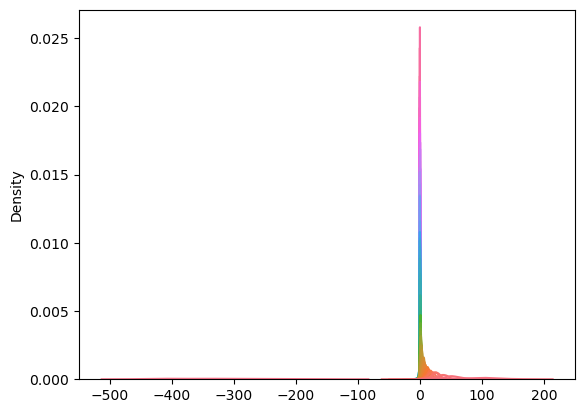

In [111]:
sns.kdeplot(x,legend=False)

<Axes: ylabel='Density'>

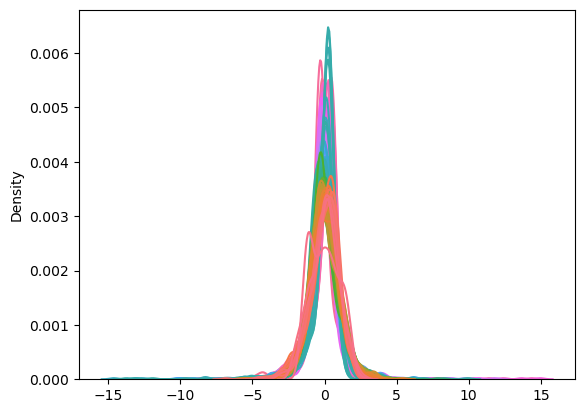

In [112]:
sns.kdeplot(xtrain,legend=False)

<Axes: ylabel='Density'>

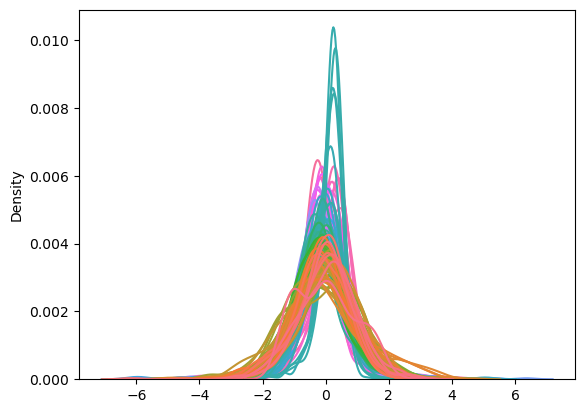

In [113]:
sns.kdeplot(xtest,legend=False)

### GNB

In [114]:
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import accuracy_score, classification_report


In [115]:
model = GaussianNB()
model.fit(xtrain,ytrain)

GaussianNB()

In [116]:
ypred = model.predict(xtest)
accuracy = accuracy_score(ytest, ypred)
print(f'Accuracy: {accuracy}')

# Display additional metrics
print('\nClassification Report:')
print(classification_report(ytest, ypred))

Accuracy: 0.7454068241469817

Classification Report:
              precision    recall  f1-score   support

           0       0.08      1.00      0.15         2
           1       0.00      0.00      0.00         6
           2       0.99      0.79      0.88       349
           3       0.09      0.06      0.07        17
           4       0.00      0.00      0.00         0
           5       0.12      0.86      0.21         7

    accuracy                           0.75       381
   macro avg       0.21      0.45      0.22       381
weighted avg       0.92      0.75      0.81       381



c:\Users\Irshad Yasseen A\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\Irshad Yasseen A\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\Irshad Yasseen A\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [117]:
set(y)

{0, 1, 2, 3, 4, 5}

In [118]:
set(ypred)

{0, 1, 2, 3, 4, 5}

In [119]:
class_labels = list(set(le.inverse_transform(ytest)))
class_labels

['Bronchiectasis', 'URTI', 'COPD', 'Healthy', 'Bronchiolitis']

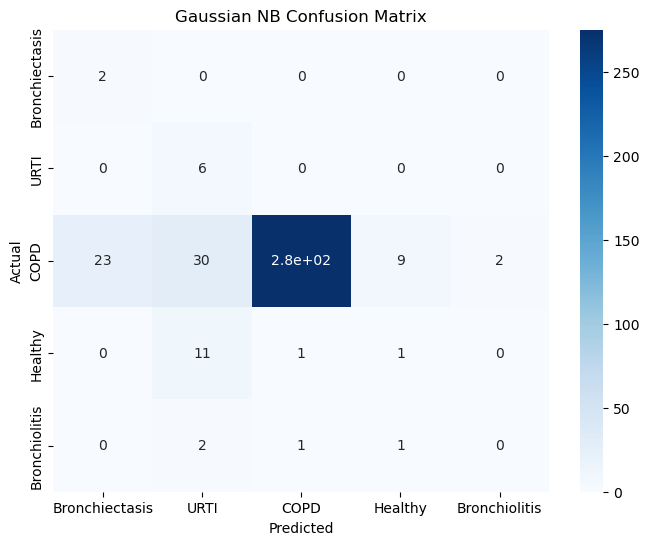

In [120]:
from sklearn.metrics import confusion_matrix
conf_matrix=confusion_matrix(le.inverse_transform(ytest),le.inverse_transform(ypred),labels=class_labels)
cm=pd.DataFrame(conf_matrix,index=class_labels,columns=class_labels)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True,  cmap="Blues")
plt.xlabel('Predicted')
plt.ylabel('Actual')
#plt.xticks(class_labels)
plt.title('Gaussian NB Confusion Matrix')
plt.show()

In [121]:
cm=pd.DataFrame(conf_matrix,index=class_labels,columns=class_labels)

In [122]:
cm

,Bronchiectasis,URTI,COPD,Healthy,Bronchiolitis
Bronchiectasis,2,0,0,0,0
URTI,0,6,0,0,0
COPD,23,30,275,9,2
Healthy,0,11,1,1,0
Bronchiolitis,0,2,1,1,0


# NN 88.8 93.7

In [123]:
import tensorflow as tf

In [124]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers   import Dense,Dropout,Activation,Flatten,LSTM,LeakyReLU
from tensorflow.keras.optimizers import Adamax
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras.utils import plot_model

In [125]:
set(le.inverse_transform(y))

{'Bronchiectasis', 'Bronchiolitis', 'COPD', 'Healthy', 'Pneumonia', 'URTI'}

In [126]:
xtrain[0].shape,   xtest.shape

((128,), (381, 128))

In [127]:
ytrain.shape , ytest.shape

((536,), (381,))

In [128]:
#88.8 93.7
m = Sequential([
    Flatten(input_shape=(xtrain.shape[1],)),  # Adjusted input shape

    Dense(1000),
    Activation('relu'),
    Dropout(0.5),

    Dense(500),
    Activation('relu'),
    Dropout(0.5),

    Dense(100),
    Activation('relu'),
    Dropout(0.5),

    Dense(len(set(y))),
    Activation('softmax'),  # Assuming it's a classification problem; use 'softmax' for the last layer
   
])

# Compile the model with an appropriate optimizer, loss, and metrics

m.compile(optimizer='sgd', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Assuming ytrain and ytest are your original labels (0, 1, 2, ..., num_classes-1)
#cp = ModelCheckpoint(filepath="d:/Vs/Model/Ann0.h5", verbose=1, save_best_only=True)
#m.fit(xtrain, ytrain, batch_size=10, epochs=25, validation_data=(xtest, ytest),callbacks=[cp])
m.fit(xtrain, ytrain, batch_size=10, epochs=25, validation_data=(xtest, ytest))

Epoch 1/25


37/54 [===================>..........] - ETA: 0s - loss: 1.0619 - accuracy: 0.7108   
Epoch 1: val_loss improved from inf to 0.49312, saving model to d:/Vs/Model\Ann0.h5
54/54 [==============================] - 1s 8ms/step - loss: 1.0197 - accuracy: 0.7332 - val_loss: 0.4931 - val_accuracy: 0.9160
Epoch 2/25
39/54 [====================>.........] - ETA: 0s - loss: 0.6977 - accuracy: 0.8359

c:\Users\Irshad Yasseen A\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(



Epoch 2: val_loss improved from 0.49312 to 0.43745, saving model to d:/Vs/Model\Ann0.h5
54/54 [==============================] - 0s 4ms/step - loss: 0.7013 - accuracy: 0.8321 - val_loss: 0.4374 - val_accuracy: 0.9160
Epoch 3/25
38/54 [====================>.........] - ETA: 0s - loss: 0.6136 - accuracy: 0.8447
Epoch 3: val_loss improved from 0.43745 to 0.40744, saving model to d:/Vs/Model\Ann0.h5
54/54 [==============================] - 0s 4ms/step - loss: 0.6316 - accuracy: 0.8302 - val_loss: 0.4074 - val_accuracy: 0.9134
Epoch 4/25
41/54 [=====================>........] - ETA: 0s - loss: 0.5633 - accuracy: 0.8220
Epoch 4: val_loss improved from 0.40744 to 0.36834, saving model to d:/Vs/Model\Ann0.h5
54/54 [==============================] - 0s 4ms/step - loss: 0.5505 - accuracy: 0.8302 - val_loss: 0.3683 - val_accuracy: 0.9134
Epoch 5/25
45/54 [========================>.....] - ETA: 0s - loss: 0.5351 - accuracy: 0.8467
Epoch 5: val_loss did not improve from 0.36834
54/54 [============

In [129]:
# 87.9
m.evaluate(xtest,ytest)

12/12 [==============================] - 0s 2ms/step - loss: 0.2396 - accuracy: 0.9239


[0.23962309956550598, 0.9238845109939575]

In [130]:
set(le.inverse_transform(y))

{'Bronchiectasis', 'Bronchiolitis', 'COPD', 'Healthy', 'Pneumonia', 'URTI'}

In [133]:
def prd(file):
    n=128
    a,s=librosa.load(file);
    mg= librosa.feature.mfcc(y=a, sr=s, n_mfcc=n)
    mfc_mean=np.mean(mg.T,axis=0).reshape(1,n)
    p=m.predict(mfc_mean)
    return(p)
p=prd(r"d:\Vs\lung\Audio Files\EP17_COPD,E W,A R M,57,M.wav")
#sns.barplot(x=list(set(le.inverse_transform(y))),y=p)
p

1/1 [==============================] - 0s 17ms/step


array([[6.5614022e-27, 3.7087306e-27, 1.0000000e+00, 1.4416457e-27,
        7.1841158e-11, 2.9224679e-25]], dtype=float32)

In [ ]:
from tensorflow.keras.models import load_model

In [ ]:
mody=load_model('D:/Vs/Ann.h5')

In [ ]:
mody.predict(fe(r"lung/download/Respiratory_Sound_Database/Respiratory_Sound_Database/audio_and_txt_files/104_1b1_Ar_sc_Litt3200.wav")).

1/1 [==============================] - 0s 19ms/step


ValueError: y should be a 1d array, got an array of shape (1, 6) instead.

In [ ]:
m.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 flatten_2 (Flatten)         (None, 128)               0         
                                                                 
 dense_8 (Dense)             (None, 1000)              129000    
                                                                 
 activation_8 (Activation)   (None, 1000)              0         
                                                                 
 dropout_6 (Dropout)         (None, 1000)              0         
                                                                 
 dense_9 (Dense)             (None, 500)               500500    
                                                                 
 activation_9 (Activation)   (None, 500)               0         
                                                                 
 dropout_7 (Dropout)         (None, 500)              

In [ ]:
m.predict(xtest[0].reshape(-1,128))

1/1 [==============================] - 0s 26ms/step


array([[3.2977701e-07, 4.1975623e-09, 9.9999928e-01, 2.3506244e-10,
        3.8698238e-07, 3.1221628e-08]], dtype=float32)

In [ ]:
m.evaluate(xtest,ytest)

12/12 [==============================] - 0s 1ms/step - loss: 0.2208 - accuracy: 0.9213


[0.22082462906837463, 0.9212598204612732]

# Removing drop 92.7 90.8

In [ ]:
#92.7 90.8
m1 = Sequential([
    Flatten(input_shape=(xtrain.shape[1],)),  # Adjusted input shape

    Dense(2000),
    Activation('relu'),
 

    Dense(1500),
    Activation('relu'),
  

    Dense(1000),
    Activation('relu'),
  

    Dense(len(set(y))),
    Activation('softmax'),  # Assuming it's a classification problem; use 'softmax' for the last layer
   
])

# Compile the model with an appropriate optimizer, loss, and metrics

m.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Assuming ytrain and ytest are your original labels (0, 1, 2, ..., num_classes-1)
cp = ModelCheckpoint(filepath="d:/Vs/AnnNd1.h5", verbose=1, save_best_only=True)
m.fit(xtrain, ytrain, batch_size=10, epochs=25, validation_data=(xtest, ytest), callbacks=[cp])


Epoch 1/25
51/54 [===========================>..] - ETA: 0s - loss: 0.1124 - accuracy: 0.9765
Epoch 1: val_loss improved from inf to 0.87354, saving model to d:/Vs\AnnNd1.h5
54/54 [==============================] - 1s 10ms/step - loss: 0.1070 - accuracy: 0.9776 - val_loss: 0.8735 - val_accuracy: 0.8950
Epoch 2/25
51/54 [===========================>..] - ETA: 0s - loss: 0.0961 - accuracy: 0.9804
Epoch 2: val_loss improved from 0.87354 to 0.78736, saving model to d:/Vs\AnnNd1.h5
54/54 [==============================] - 0s 7ms/step - loss: 0.1095 - accuracy: 0.9776 - val_loss: 0.7874 - val_accuracy: 0.8950
Epoch 3/25
48/54 [=========================>....] - ETA: 0s - loss: 0.0927 - accuracy: 0.9708
Epoch 3: val_loss did not improve from 0.78736
54/54 [==============================] - 0s 5ms/step - loss: 0.0833 - accuracy: 0.9739 - val_loss: 1.3999 - val_accuracy: 0.8898
Epoch 4/25
53/54 [============================>.] - ETA: 0s - loss: 0.1453 - accuracy: 0.9717
Epoch 4: val_loss improve

In [ ]:
m.evaluate(xtest,ytest)

12/12 [==============================] - 0s 1ms/step - loss: 0.2670 - accuracy: 0.9081


[0.26704227924346924, 0.9081364870071411]

# Lrelu 88 93.1

In [ ]:
#88 93.1
m = Sequential([
    Flatten(input_shape=(50,)),  # Adjusted input shape

    Dense(100),
    LeakyReLU(alpha=0.01),  # Use Leaky ReLU with a small slope (e.g., alpha=0.01)
    Dropout(0.5),

    Dense(200),
    LeakyReLU(alpha=0.01),
    Dropout(0.5),

    Dense(100),
    LeakyReLU(alpha=0.01),
    Dropout(0.5),

    Dense(len(set(y))),
    Activation('softmax'),  # Assuming it's a classification problem; use 'softmax' for the last layer
])

# Compile the model with an appropriate optimizer, loss, and metrics
m.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Assuming ytrain and ytest are your original labels (0, 1, 2, ..., num_classes-1)
#cp = ModelCheckpoint(filepath="d:/Vs/AnnLR.h5", verbose=1, save_best_only=True)
#m.fit(xtrain, ytrain, batch_size=10, epochs=25, validation_data=(xtest, ytest), callbacks=[cp])
m.fit(xtrain, ytrain, batch_size=10, epochs=25, validation_data=(xtest, ytest))

Epoch 1/25


28/54 [==============>...............] - ETA: 0s - loss: 1.1592 - accuracy: 0.6714 
Epoch 1: val_loss improved from inf to 0.41169, saving model to d:/Vs\AnnLR.h5
54/54 [==============================] - 1s 7ms/step - loss: 0.9746 - accuracy: 0.7481 - val_loss: 0.4117 - val_accuracy: 0.9160
Epoch 2/25
43/54 [======================>.......] - ETA: 0s - loss: 0.6857 - accuracy: 0.8395
Epoch 2: val_loss improved from 0.41169 to 0.41131, saving model to d:/Vs\AnnLR.h5
54/54 [==============================] - 0s 3ms/step - loss: 0.7120 - accuracy: 0.8302 - val_loss: 0.4113 - val_accuracy: 0.9160
Epoch 3/25
44/54 [=======================>......] - ETA: 0s - loss: 0.5764 - accuracy: 0.8341
Epoch 3: val_loss improved from 0.41131 to 0.38770, saving model to d:/Vs\AnnLR.h5
54/54 [==============================] - 0s 3ms/step - loss: 0.6027 - accuracy: 0.8265 - val_loss: 0.3877 - val_accuracy: 0.9160
Epoch 4/25
44/54 [=======================>......] - ETA: 0s - loss: 0.5869 - accuracy: 0.8273
Ep

In [ ]:
m.evaluate(xtest,ytest)

12/12 [==============================] - 0s 2ms/step - loss: 1.0319 - accuracy: 0.8898


[1.0318827629089355, 0.8897637724876404]

# Adding normalization 93 89

In [1]:
from keras.layers import BatchNormalization

m1 = Sequential([
    Flatten(input_shape=(50,)),
    
    Dense(100),
    BatchNormalization(),
    Activation('relu'),
    
    Dense(150),
    BatchNormalization(),
    Activation('relu'),
    
    Dense(50),
    BatchNormalization(),
    Activation('relu'),
    
    Dense(len(set(y))),
    Activation('softmax'),
])
m1.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])
#cp = ModelCheckpoint(filepath="d:/Vs/AnnNorm.h5", verbose=1, save_best_only=True)
#m1.fit(xtrain, ytrain, batch_size=10, epochs=30, validation_data=(xtest, ytest), callbacks=[cp])
m1.fit(xtrain, ytrain, batch_size=10, epochs=30, validation_data=(xtest, ytest))



NameError: name 'Sequential' is not defined

In [ ]:
m1.evaluate(xtest,ytest)

12/12 [==============================] - 0s 1ms/step - loss: 0.3445 - accuracy: 0.9055


[0.3444771468639374, 0.9055117964744568]

# lrelu no drop 99 89

In [ ]:
#91.3
m = Sequential([
    Flatten(input_shape=(50,)),  # Adjusted input shape

    Dense(100),
    LeakyReLU(alpha=0.01),  # Use Leaky ReLU with a small slope (e.g., alpha=0.01)
   # Dropout(0.5),
 
    Dense(200),
    LeakyReLU(alpha=0.01),
#    Dropout(0.5),

    Dense(100),
    LeakyReLU(alpha=0.01),
 #   Dropout(0.5),

    Dense(len(set(y))),
    Activation('softmax'),  # Assuming it's a classification problem; use 'softmax' for the last layer
])

# Compile the model with an appropriate optimizer, loss, and metrics
m.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Assuming ytrain and ytest are your original labels (0, 1, 2, ..., num_classes-1)
#cp = ModelCheckpoint(filepath="d:/Vs/AnnLrNd.h5", verbose=1, save_best_only=True)
#m.fit(xtrain, ytrain, batch_size=10, epochs=25, validation_data=(xtest, ytest), callbacks=[cp])
m.fit(xtrain, ytrain, batch_size=10, epochs=25, validation_data=(xtest, ytest))


Epoch 1/25


40/54 [=====================>........] - ETA: 0s - loss: 0.7377 - accuracy: 0.8075 
Epoch 1: val_loss improved from inf to 0.30570, saving model to d:/Vs\AnnLrNd.h5
54/54 [==============================] - 1s 5ms/step - loss: 0.6794 - accuracy: 0.8134 - val_loss: 0.3057 - val_accuracy: 0.9318
Epoch 2/25
44/54 [=======================>......] - ETA: 0s - loss: 0.3829 - accuracy: 0.8545
Epoch 2: val_loss improved from 0.30570 to 0.28850, saving model to d:/Vs\AnnLrNd.h5
54/54 [==============================] - 0s 2ms/step - loss: 0.3893 - accuracy: 0.8582 - val_loss: 0.2885 - val_accuracy: 0.9160
Epoch 3/25
52/54 [===========================>..] - ETA: 0s - loss: 0.2975 - accuracy: 0.8788
Epoch 3: val_loss improved from 0.28850 to 0.23051, saving model to d:/Vs\AnnLrNd.h5
54/54 [==============================] - 0s 3ms/step - loss: 0.2941 - accuracy: 0.8806 - val_loss: 0.2305 - val_accuracy: 0.9213
Epoch 4/25
 1/54 [..............................] - ETA: 0s - loss: 0.0924 - accuracy: 1.0

In [ ]:
m.evaluate(xtest,ytest)

12/12 [==============================] - 0s 594us/step - loss: 0.3809 - accuracy: 0.9108


[0.38089314103126526, 0.9107611775398254]

# lstm 85 91

In [ ]:
xtrain.shape,\
xtrain.shape,\
#xtrain_reshaped.shape,\
ytrain.shape


(536,)

91.86

In [ ]:
from keras.models import Sequential
from keras.layers import LSTM, Dense, Dropout
from keras.callbacks import ModelCheckpoint
#91.86
# Assuming xtrain, xtest, ytrain, ytest are your training and testing sets

# Reshape the input data for LSTM (assuming a time sequence of length 50)
xtrain_reshaped = xtrain.reshape(xtrain.shape[0], xtrain.shape[1], 1)
xtest_reshaped = xtest.reshape(xtest.shape[0], xtest.shape[1], 1)

# Define the LSTM model
model = Sequential()
model.add(LSTM(100, input_shape=(xtrain_reshaped.shape[1], 1), return_sequences=True))
model.add(Dropout(0.5))
model.add(LSTM(100))
model.add(Dropout(0.5))
model.add(Dense(len(set(y)), activation='softmax'))

# Compile the model
model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# ModelCheckpoint callback to save the best model
checkpoint = ModelCheckpoint(filepath="d:/Vs/Lstm.h5", verbose=1, save_best_only=True)

#model.fit(xtrain_reshaped, ytrain, epochs=25, batch_size=32, validation_data=(xtest_reshaped, ytest), callbacks=[checkpoint])
model.fit(xtrain_reshaped, ytrain, epochs=25, batch_size=32, validation_data=(xtest_reshaped, ytest))


Epoch 1/25
16/17 [===========================>..] - ETA: 0s - loss: 1.2725 - accuracy: 0.6660
Epoch 1: val_loss improved from inf to 0.44972, saving model to d:/Vs\Lstm.h5
17/17 [==============================] - 4s 74ms/step - loss: 1.2296 - accuracy: 0.6772 - val_loss: 0.4497 - val_accuracy: 0.9160
Epoch 2/25
17/17 [==============================] - ETA: 0s - loss: 0.7194 - accuracy: 0.8228
Epoch 2: val_loss did not improve from 0.44972
17/17 [==============================] - 1s 31ms/step - loss: 0.7194 - accuracy: 0.8228 - val_loss: 0.4860 - val_accuracy: 0.9029
Epoch 3/25
17/17 [==============================] - ETA: 0s - loss: 0.6288 - accuracy: 0.8246
Epoch 3: val_loss improved from 0.44972 to 0.37601, saving model to d:/Vs\Lstm.h5
17/17 [==============================] - 1s 38ms/step - loss: 0.6288 - accuracy: 0.8246 - val_loss: 0.3760 - val_accuracy: 0.9160
Epoch 4/25
17/17 [==============================] - ETA: 0s - loss: 0.5879 - accuracy: 0.8265
Epoch 4: val_loss did not i

In [ ]:
model.evaluate(xtest_reshaped,ytest)

 1/12 [=>............................] - ETA: 0s - loss: 0.4618 - accuracy: 0.8125

12/12 [==============================] - 0s 10ms/step - loss: 0.3356 - accuracy: 0.9055


[0.3355979919433594, 0.9055117964744568]

# Lstm no drp 88 90

In [ ]:
from keras.models import Sequential
from keras.layers import LSTM, Dense, Dropout
from keras.callbacks import ModelCheckpoint
#91.86
xtrain_reshaped = xtrain.reshape(xtrain.shape[0], xtrain.shape[1], 1)
xtest_reshaped = xtest.reshape(xtest.shape[0], xtest.shape[1], 1)

model = Sequential()
model.add(LSTM(100, input_shape=(xtrain_reshaped.shape[1], 1), return_sequences=True))
model.add(LSTM(100))
model.add(Dense(len(set(y)), activation='softmax'))

# Compile the model
model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

#checkpoint = ModelCheckpoint(filepath="d:/Vs/LstmNd.h5", verbose=1, save_best_only=True)

# Train the model
model.fit(xtrain_reshaped, ytrain, epochs=25, batch_size=32, validation_data=(xtest_reshaped, ytest))


Epoch 1/25
15/17 [=========================>....] - ETA: 0s - loss: 1.2026 - accuracy: 0.6500
Epoch 1: val_loss improved from inf to 0.42369, saving model to d:/Vs\LstmNd.h5
17/17 [==============================] - 3s 70ms/step - loss: 1.2026 - accuracy: 0.6623 - val_loss: 0.4237 - val_accuracy: 0.9160
Epoch 2/25
15/17 [=========================>....] - ETA: 0s - loss: 0.6357 - accuracy: 0.8271
Epoch 2: val_loss improved from 0.42369 to 0.41849, saving model to d:/Vs\LstmNd.h5
17/17 [==============================] - 1s 32ms/step - loss: 0.6267 - accuracy: 0.8284 - val_loss: 0.4185 - val_accuracy: 0.9160
Epoch 3/25
16/17 [===========================>..] - ETA: 0s - loss: 0.5929 - accuracy: 0.8262
Epoch 3: val_loss improved from 0.41849 to 0.39478, saving model to d:/Vs\LstmNd.h5
17/17 [==============================] - 1s 33ms/step - loss: 0.5844 - accuracy: 0.8284 - val_loss: 0.3948 - val_accuracy: 0.9160
Epoch 4/25
17/17 [==============================] - ETA: 0s - loss: 0.5699 - acc

# evano error uhh

In [ ]:
# Assuming xtrain has shape (733, 50)
timesteps = 536  # Adjust the number of time steps as needed1
features_per_timestep = 50  # Adjust the number of features per time step as needed

# Reshape xtrain into a 3D array with shape (733, timesteps, features_per_timestep)
xtrain_reshaped = xtrain.reshape( 1,xtrain.shape[0], features_per_timestep)
xtest_reshaped=  xtest.reshape(1,xtest.shape[0], features_per_timestep)
m_lstm = Sequential([
    LSTM(100, input_shape=(timesteps, features_per_timestep), return_sequences=True),
    Dropout(0.5),
    
    LSTM(200, return_sequences=True),
    Dropout(0.5),
    
    LSTM(200),
    Dropout(0.5),
    
    Dense(100, activation='relu'),
    Dropout(0.5),
    
    Dense(len(set(y)), activation='softmax')
])
m_lstm.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])
#cp = ModelCheckpoint(filepath="d:/Vs/model_checkpointLSTM.h5", verbose=1, save_best_only=True)
#m_lstm.fit(xtrain_reshaped, ytrain, batch_size=10, epochs=100, callbacks=[cp])
m_lstm.fit(xtrain_reshaped, ytrain, batch_size=10, epochs=100,)


NameError: name 'features' is not defined

In [ ]:
m_lstm.evaluate(xtest_reshaped,ytest)

# Cnn no drp 98 71

In [ ]:
from keras.models import Sequential
from keras.layers import Conv1D, MaxPooling1D, Flatten, Dense

# Reshape xtrain for CNN input
# Assuming xtrain has shape (733, 50)
xtrain_reshaped = xtrain.reshape(xtrain.shape[0], xtrain.shape[1], 1)

# Define CNN model
model = Sequential()
model.add(Conv1D(filters=64, kernel_size=3, activation='relu', input_shape=(xtrain.shape[1], 1)))
model.add(MaxPooling1D(pool_size=2))
model.add(Flatten())
model.add(Dense(100, activation='relu'))
model.add(Dense(len(set(y)), activation='softmax'))

# Compile the model
model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])
#cp = ModelCheckpoint(filepath="d:/Vs/model_checkpoint_cnn_Nd.h5", verbose=1, save_best_only=True)
#model.fit(xtrain_reshaped, ytrain, epochs=25, batch_size=10,callbacks=[cp], validation_split=0.2)
model.fit(xtrain_reshaped, ytrain, epochs=25, batch_size=10, validation_split=0.2)



Epoch 1/25
27/43 [=================>............] - ETA: 0s - loss: 0.7517 - accuracy: 0.8000     
Epoch 1: val_loss improved from inf to 1.06323, saving model to d:/Vs\model_checkpoint_cnn_Nd.h5
43/43 [==============================] - 1s 6ms/step - loss: 0.6535 - accuracy: 0.8201 - val_loss: 1.0632 - val_accuracy: 0.7963
Epoch 2/25
24/43 [===============>..............] - ETA: 0s - loss: 0.5257 - accuracy: 0.8167
Epoch 2: val_loss improved from 1.06323 to 0.97321, saving model to d:/Vs\model_checkpoint_cnn_Nd.h5
43/43 [==============================] - 0s 3ms/step - loss: 0.4486 - accuracy: 0.8435 - val_loss: 0.9732 - val_accuracy: 0.7685
Epoch 3/25
28/43 [==================>...........] - ETA: 0s - loss: 0.4035 - accuracy: 0.8643
Epoch 3: val_loss improved from 0.97321 to 0.86471, saving model to d:/Vs\model_checkpoint_cnn_Nd.h5
43/43 [==============================] - 0s 3ms/step - loss: 0.3762 - accuracy: 0.8621 - val_loss: 0.8647 - val_accuracy: 0.7685
Epoch 4/25
30/43 [========

In [ ]:
#model.evaluate(xtest,ytest)

: 

# CNN 90 92

92

In [ ]:
from keras.models import Sequential
from keras.layers import Conv1D, MaxPooling1D, Flatten, Dense, Dropout
from keras.callbacks import ModelCheckpoint

# Assuming xtrain, xtest, ytrain, ytest are your training and testing sets

# Reshape the input data for CNN (assuming a time sequence of length 50)
xtrain_reshaped = xtrain.reshape(xtrain.shape[0], xtrain.shape[1], 1)
xtest_reshaped = xtest.reshape(xtest.shape[0], xtest.shape[1], 1)
model = Sequential()
model.add(Conv1D(filters=32, kernel_size=3, activation='relu', input_shape=(xtrain_reshaped.shape[1], 1)))
model.add(MaxPooling1D(pool_size=2))
model.add(Dropout(0.5))
model.add(Flatten())
model.add(Dense(100, activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(len(set(y)), activation='softmax'))
model.compile(optimizer='sgd', loss='sparse_categorical_crossentropy', metrics=['accuracy'])
checkpoint = ModelCheckpoint(filepath="best_cnn_model.h5", verbose=1, save_best_only=True)
#model.fit(xtrain_reshaped, ytrain, epochs=50, batch_size=32, validation_data=(xtest_reshaped, ytest), callbacks=[checkpoint])
model.fit(xtrain_reshaped, ytrain, epochs=50, batch_size=32, validation_data=(xtest_reshaped, ytest))



Epoch 1/50
17/17 [==============================] - ETA: 0s - loss: 1.4146 - accuracy: 0.5485
Epoch 1: val_loss improved from inf to 0.78214, saving model to best_cnn_model.h5
17/17 [==============================] - 1s 17ms/step - loss: 1.4146 - accuracy: 0.5485 - val_loss: 0.7821 - val_accuracy: 0.9160
Epoch 2/50
15/17 [=========================>....] - ETA: 0s - loss: 0.9056 - accuracy: 0.8146
Epoch 2: val_loss improved from 0.78214 to 0.50081, saving model to best_cnn_model.h5
17/17 [==============================] - 0s 8ms/step - loss: 0.9041 - accuracy: 0.8172 - val_loss: 0.5008 - val_accuracy: 0.9160


c:\Users\Irshad Yasseen A\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Epoch 3/50
16/17 [===========================>..] - ETA: 0s - loss: 0.7710 - accuracy: 0.8242
Epoch 3: val_loss improved from 0.50081 to 0.43352, saving model to best_cnn_model.h5
17/17 [==============================] - 0s 7ms/step - loss: 0.7821 - accuracy: 0.8228 - val_loss: 0.4335 - val_accuracy: 0.9160
Epoch 4/50
 1/17 [>.............................] - ETA: 0s - loss: 0.3735 - accuracy: 0.9375
Epoch 4: val_loss improved from 0.43352 to 0.40294, saving model to best_cnn_model.h5
17/17 [==============================] - 0s 6ms/step - loss: 0.7417 - accuracy: 0.8284 - val_loss: 0.4029 - val_accuracy: 0.9160
Epoch 5/50
 1/17 [>.............................] - ETA: 0s - loss: 0.2926 - accuracy: 0.9375
Epoch 5: val_loss improved from 0.40294 to 0.38823, saving model to best_cnn_model.h5
17/17 [==============================] - 0s 7ms/step - loss: 0.7296 - accuracy: 0.8284 - val_loss: 0.3882 - val_accuracy: 0.9160
Epoch 6/50
16/17 [===========================>..] - ETA: 0s - loss: 0.680

# Hyb

### err

In [ ]:
"""from keras.models import Sequential
from keras.layers import Conv1D, MaxPooling1D, LSTM, Dense, Dropout, Flatten
from keras.callbacks import ModelCheckpoint

# Assuming xtrain, xtest, ytrain, ytest are your training and testing sets

# Reshape the input data for CNN (assuming a time sequence of length 50)
xtrain_reshaped = xtrain.reshape(xtrain.shape[0], xtrain.shape[1], 1)
xtest_reshaped = xtest.reshape(xtest.shape[0], xtest.shape[1], 1)

# Define the combined model
model = Sequential()

# CNN layers
model.add(Conv1D(filters=32, kernel_size=3, activation='relu', input_shape=(xtrain_reshaped.shape[1], 1)))
model.add(MaxPooling1D(pool_size=2))
model.add(Dropout(0.5))
model.add(Flatten())

# LSTM layers
model.add(LSTM(50, activation='relu', input_shape=(xtrain_reshaped.shape[1], 1)))

# Dense layers
model.add(Dense(100, activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(len(set(y)), activation='softmax'))

# Compile the model
model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# ModelCheckpoint callback to save the best model
checkpoint = ModelCheckpoint(filepath="best_lstm_hyb_model.h5", verbose=1, save_best_only=True)

# Train the model
model.fit(xtrain_reshaped, ytrain, epochs=50, batch_size=32, validation_data=(xtest_reshaped, ytest), callbacks=[checkpoint])
"""

ValueError: Input 0 of layer "lstm_5" is incompatible with the layer: expected ndim=3, found ndim=2. Full shape received: (None, 768)

### lstm cnn 87 90

In [ ]:
from keras.models import Sequential
from keras.layers import Conv1D, MaxPooling1D, LSTM, Dense, Flatten, Dropout

# Assuming xtrain and ytrain are your training data
# Assuming xtest and ytest are your testing data

# Reshape the input data for CNN
xtrain_reshaped = xtrain.reshape(xtrain.shape[0], xtrain.shape[1], 1)
xtest_reshaped = xtest.reshape(xtest.shape[0], xtest.shape[1], 1)

# Build the hybrid model
model = Sequential()

# CNN layers
model.add(Conv1D(filters=32, kernel_size=3, activation='relu', input_shape=(xtrain_reshaped.shape[1], 1)))
model.add(MaxPooling1D(pool_size=2))
model.add(Dropout(0.5))

# LSTM layer
model.add(LSTM(50, activation='relu'))

# Fully connected layers
model.add(Dense(100, activation='relu'))
model.add(Dense(len(set(ytrain)), activation='softmax'))  # Assuming it's a classification problem

# Compile the model
model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# ModelCheckpoint callback to save the best model
checkpoint = ModelCheckpoint(filepath="best_lstm_cnn_model.h5", verbose=1, save_best_only=True)

# Train the model
#model.fit(xtrain_reshaped, ytrain, epochs=25, batch_size=32, validation_data=(xtest_reshaped, ytest), callbacks=[checkpoint])
model.fit(xtrain_reshaped, ytrain, epochs=25, batch_size=32, validation_data=(xtest_reshaped, ytest))


Epoch 1/25
12/17 [====================>.........] - ETA: 0s - loss: 1.5716 - accuracy: 0.7474
Epoch 1: val_loss improved from inf to 0.56943, saving model to best_lstm_cnn_model.h5
17/17 [==============================] - 2s 25ms/step - loss: 1.4050 - accuracy: 0.7854 - val_loss: 0.5694 - val_accuracy: 0.9160
Epoch 2/25
17/17 [==============================] - ETA: 0s - loss: 0.9367 - accuracy: 0.8284
Epoch 2: val_loss did not improve from 0.56943
17/17 [==============================] - 0s 10ms/step - loss: 0.9367 - accuracy: 0.8284 - val_loss: 0.8007 - val_accuracy: 0.9160
Epoch 3/25
10/17 [================>.............] - ETA: 0s - loss: 0.8326 - accuracy: 0.8500
Epoch 3: val_loss improved from 0.56943 to 0.49168, saving model to best_lstm_cnn_model.h5
17/17 [==============================] - 0s 13ms/step - loss: 0.8186 - accuracy: 0.8284 - val_loss: 0.4917 - val_accuracy: 0.9160
Epoch 4/25
 9/17 [==============>...............] - ETA: 0s - loss: 0.7575 - accuracy: 0.8333
Epoch 4: 

In [ ]:
model.evaluate(xtest_reshaped,ytest)

12/12 [==============================] - 0s 3ms/step - loss: 0.3723 - accuracy: 0.9003


[0.3723371922969818, 0.9002624750137329]

In [ ]:
model.summary()

Model: "sequential_12"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_5 (Conv1D)           (None, 48, 32)            128       
                                                                 
 max_pooling1d_5 (MaxPoolin  (None, 24, 32)            0         
 g1D)                                                            
                                                                 
 dropout_13 (Dropout)        (None, 24, 32)            0         
                                                                 
 lstm_7 (LSTM)               (None, 50)                16600     
                                                                 
 dense_28 (Dense)            (None, 100)               5100      
                                                                 
 dense_29 (Dense)            (None, 6)                 606       
                                                     

# hyb 99 92

In [ ]:
from keras.models import Sequential
from keras.layers import Conv1D, MaxPooling1D, LSTM, Dense, Flatten, Dropout

# Assuming xtrain and ytrain are your training data
# Assuming xtest and ytest are your testing data

# Reshape the input data for CNN
xtrain_reshaped = xtrain.reshape(xtrain.shape[0], xtrain.shape[1], 1)
xtest_reshaped = xtest.reshape(xtest.shape[0], xtest.shape[1], 1)

# Build the hybrid model
model = Sequential()

# CNN layers
model.add(Conv1D(filters=32, kernel_size=3, activation='relu', input_shape=(xtrain_reshaped.shape[1], 1)))
model.add(MaxPooling1D(pool_size=2))
model.add(Dropout(0.5))

# LSTM layer
model.add(LSTM(50, activation='relu'))

# Fully connected layers
model.add(Dense(100, activation='relu'))
model.add(Dense(len(set(ytrain)), activation='softmax'))  # Assuming it's a classification problem

# Compile the model
model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# ModelCheckpoint callback to save the best model
checkpoint = ModelCheckpoint(filepath="best_lstm_cnn_model_nodrpp.h5", verbose=1, save_best_only=True)

# Train the model
#model.fit(xtrain_reshaped, ytrain, epochs=500, batch_size=32, validation_data=(xtest_reshaped, ytest), callbacks=[checkpoint])
model.fit(xtrain_reshaped, ytrain, epochs=500, batch_size=32, validation_data=(xtest_reshaped, ytest))


Epoch 1/500
17/17 [==============================] - ETA: 0s - loss: 1.5009 - accuracy: 0.7519
Epoch 1: val_loss improved from inf to 0.66247, saving model to best_lstm_cnn_model_nodrpp.h5
17/17 [==============================] - 1s 24ms/step - loss: 1.5009 - accuracy: 0.7519 - val_loss: 0.6625 - val_accuracy: 0.9160
Epoch 2/500
17/17 [==============================] - ETA: 0s - loss: 0.8989 - accuracy: 0.8284
Epoch 2: val_loss improved from 0.66247 to 0.56167, saving model to best_lstm_cnn_model_nodrpp.h5
17/17 [==============================] - 0s 12ms/step - loss: 0.8989 - accuracy: 0.8284 - val_loss: 0.5617 - val_accuracy: 0.9160
Epoch 3/500
10/17 [================>.............] - ETA: 0s - loss: 0.7914 - accuracy: 0.8156
Epoch 3: val_loss improved from 0.56167 to 0.40570, saving model to best_lstm_cnn_model_nodrpp.h5
17/17 [==============================] - 0s 10ms/step - loss: 0.7294 - accuracy: 0.8284 - val_loss: 0.4057 - val_accuracy: 0.9160
Epoch 4/500
10/17 [================

In [ ]:
model.evaluate(xtest_reshaped,ytest)

 1/12 [=>............................] - ETA: 0s - loss: 1.0623 - accuracy: 0.8438

12/12 [==============================] - 0s 4ms/step - loss: 0.7456 - accuracy: 0.9186


[0.7456261515617371, 0.9186351895332336]

In [ ]:
model.summary()

Model: "sequential_13"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_6 (Conv1D)           (None, 48, 32)            128       
                                                                 
 max_pooling1d_6 (MaxPoolin  (None, 24, 32)            0         
 g1D)                                                            
                                                                 
 dropout_14 (Dropout)        (None, 24, 32)            0         
                                                                 
 lstm_8 (LSTM)               (None, 50)                16600     
                                                                 
 dense_30 (Dense)            (None, 100)               5100      
                                                                 
 dense_31 (Dense)            (None, 6)                 606       
                                                     

In [ ]:
y_pred = model.predict(xtest_reshaped[0])

: 

In [ ]:
from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming you have loaded your model and compiled it as 'model'

# Predict on the new data
y_pred = model.predict(xtest_reshaped)

# Generate confusion matrix
cm = confusion_matrix(ytest, y_pred)

# Display the confusion matrix using a heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues")
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()


12/12 [==============================] - 0s 3ms/step


ValueError: Classification metrics can't handle a mix of multiclass and continuous-multioutput targets

# UI

In [ ]:
xtrain.shape()

NameError: name 'xtrain' is not defined

In [ ]:
#pip install gradio
